In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
import geopandas as gpd
import os
from folium.plugins import HeatMap
import seaborn as sns
from sklearn.preprocessing import RobustScaler
from sklearn.cluster import KMeans
import joblib

In [38]:
from slcities.get_data import DataMerger
from slcities.utils import format_df_to_geopandas
from slcities.params import DUBLIN_CENTER_COORDS
from slcities.utils import dataframe_to_geopandas
from slcities.lights_models import night_length

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
pd.set_option('display.max_columns', None)

## Nice Places Data 

In [5]:
from slcities.get_data import GmapApiCallPreProcessing
from slcities.utils import dataframe_to_geopandas
from slcities.polygons import containers

In [6]:
## Open, merge, filter and format all the API calls
input_dir = '../raw_data/places/nice/02-09-2021_14-57-26'
api_call_pp = GmapApiCallPreProcessing()
api_call_pp.open_results(input_dir)
api_call_pp.extract_and_format_results()
api_call_pp.filter_results()
places_nice_df = api_call_pp.return_df()

In [7]:
## Transform lat and lon into points type
gpd_places_nice = dataframe_to_geopandas(places_nice_df)

In [8]:
## Open Nice geodata (areas)
nice_polygons=gpd.read_file('../slcities/data/geodata_nice.json')
nice_polygons['ED_ID']=nice_polygons['CODE_IRIS']

In [9]:
nice_polygons.head()

,id,CODE_IRIS,NOM_IRIS,area,density,population,geometry,ED_ID
0,0,60882705,Abbaye de Roseland,0.38,5313.16,2019,"POLYGON ((7.23201 43.69345, 7.23197 43.69347, ...",60882705
1,1,60881602,Acropolis-XVe Corps,0.26,8676.92,2256,"POLYGON ((7.27902 43.71052, 7.27866 43.71056, ...",60881602
2,2,60883001,Arenas-Aéroport,4.30,134.88,580,"POLYGON ((7.20012 43.66450, 7.19960 43.66430, ...",60883001
3,3,60883002,Arenas-Cassin,0.16,17943.75,2871,"POLYGON ((7.21943 43.67236, 7.21937 43.67232, ...",60883002
4,4,60880901,Ariane-Les Chênes,0.15,15833.33,2375,"POLYGON ((7.29541 43.73765, 7.29538 43.73760, ...",60880901


In [11]:
## Assign polygons to each places
gpd_places_nices_with_area = containers(gpd_places_nice, nice_polygons)

In [83]:
gpd_places_nices_with_area.head()

,place_id,latitude,longitude,place,geometry,ED_ID
0,ChIJVVWl-Q7QzRIR8SXZrNkSjrA,43.701036,7.257405,car_dealer,POINT (7.25741 43.70104),60882303
1,ChIJZ3_iKRLQzRIRUb9NYKw83Us,43.699467,7.252191,car_dealer,POINT (7.25219 43.69947),60882504
2,ChIJZ3_iKRLQzRIRUb_GN06b2lc,43.699467,7.252191,car_dealer,POINT (7.25219 43.69947),60882504
3,ChIJEcEKKhLQzRIRmuoEsw9OK20,43.699467,7.252191,car_dealer,POINT (7.25219 43.69947),60882504
4,ChIJL4D3kg_QzRIROFw1o1E_MAM,43.703293,7.255888,store,POINT (7.25589 43.70329),60881901


In [84]:
## Get counts per area
ED_ID_col, place_col = 'ED_ID', 'place'
global_cnt_nice = gpd_places_nices_with_area.groupby(by=[ED_ID_col, place_col]).size().unstack().fillna(
            0).reset_index()

In [85]:
global_cnt_nice.shape

(142, 54)

In [86]:
## Set primary_school to 0 cause we had some recurent issues with the primary_school during the API call
global_cnt_nice['primary_school']=0

In [87]:
## Get the population and the surface per area
global_cnt_nice = global_cnt_nice.merge(nice_polygons[['ED_ID', 'area', 'population', 'geometry']], how='right')

In [88]:
global_cnt_nice = global_cnt_nice.rename(columns = {'area':'Shape__Area', 'population':'pop'})

In [89]:
## There are no shop at all in 4 areas. We'll set 0 for those areas
global_cnt_nice = global_cnt_nice.fillna(0)

In [90]:
## There are no rv_park in the dataframe we used  to  predict the clustering model
## hence we'll delete it from the current dataframe
global_cnt_nice = global_cnt_nice.drop(columns='rv_park')

In [91]:
global_cnt_nice.shape

(146, 56)

In [92]:
## Re-order the dataframe according to the one that have been used for to fit the model
columns_order = ['ED_ID', 'Shape__Area', 'geometry', 'art_gallery', 'atm', 'bakery',
       'bank', 'bar', 'beauty_salon', 'bus_station', 'cafe', 'car_dealer',
       'car_rental', 'car_repair', 'car_wash', 'clothing_store',
       'convenience_store', 'department_store', 'doctor', 'drugstore',
       'electrician', 'electronics_store', 'food', 'furniture_store',
       'gas_station', 'grocery_or_supermarket', 'gym', 'hair_care',
       'hardware_store', 'health', 'home_goods_store', 'hospital',
       'jewelry_store', 'laundry', 'liquor_store', 'local_government_office',
       'lodging', 'movie_theater', 'museum', 'night_club', 'park', 'parking',
       'pharmacy', 'plumber', 'police', 'post_office', 'primary_school',
       'real_estate_agency', 'restaurant', 'school', 'shopping_mall', 'spa',
       'stadium', 'store', 'supermarket', 'pop']
global_cnt_nice = global_cnt_nice[columns_order]

### Apply the clustering model

In [93]:
## Getting the data
X_cnt_nice = global_cnt_nice.drop(columns=['ED_ID', 'geometry'])

In [94]:
robust_scaler = joblib.load('../slcities/model/slcities_robust_scaler')

In [95]:
X_scaled_nice = robust_scaler.transform(X_cnt_nice)

In [96]:
## Importation of the trained model
k = 4
trained_kmeans_k4 = joblib.load('../slcities/model/trained_kmeans_k4.model')

In [111]:
## Data clustering
gpd_global_cnt_nice = global_cnt_nice.copy()
gpd_global_cnt_nice['cluster'] = trained_kmeans_k4.predict(X_scaled_nice)

In [112]:
gpd_global_cnt_nice['cluster'].value_counts()

0    117
2     27
1      2
Name: cluster, dtype: int64

In [113]:
## Renaming the cluster the same way as we did for dublin
gpd_global_cnt_nice['cluster'] = gpd_global_cnt_nice['cluster'].map({3:1,
                                                           0:2,
                                                           2:3,
                                                           1:4})
# gpd_global_cnt_nice['cluster'] = gpd_global_cnt_nice['cluster'].map({
#                                                            2:3})

In [66]:
global_cnt_nice['cluster'].value_counts()

2    117
3     27
4      2
Name: cluster, dtype: int64

In [115]:
## Transform into geopandas 
gpd_global_cnt_nice = gpd.GeoDataFrame(gpd_global_cnt_nice, geometry='geometry', crs="EPSG:4326")

In [46]:
# gpd_global_cnt_nice.to_csv('../slcities/data/gpd_global_cnt_nice.txt')

In [118]:
# gpd_global_cnt_nice.to_file("../slcities/data/gpd_global_cnt_nice.geojson", driver='GeoJSON')


# Files imports

In [23]:
## import
places = pd.read_csv('../slcities/data/places.txt')
areas = pd.read_csv('../slcities/data/areas.txt')
lights = pd.read_csv('../slcities/data/lights.txt')
sensors = pd.read_csv('../slcities/data/sensors.txt')
daylight_df = pd.read_csv('../slcities/data/daylight.txt')
global_cnt_df = pd.read_csv('../slcities/data/global_cnt.txt')

In [24]:
## Transform into geopandas 
gpd_global_cnt = format_df_to_geopandas(global_cnt_df)

In [98]:
gpd_global_cnt.columns

Index(['ED_ID', 'Shape__Area', 'geometry', 'art_gallery', 'atm', 'bakery',
       'bank', 'bar', 'beauty_salon', 'bus_station', 'cafe', 'car_dealer',
       'car_rental', 'car_repair', 'car_wash', 'clothing_store',
       'convenience_store', 'department_store', 'doctor', 'drugstore',
       'electrician', 'electronics_store', 'food', 'furniture_store',
       'gas_station', 'grocery_or_supermarket', 'gym', 'hair_care',
       'hardware_store', 'health', 'home_goods_store', 'hospital',
       'jewelry_store', 'laundry', 'liquor_store', 'local_government_office',
       'lodging', 'movie_theater', 'museum', 'night_club', 'park', 'parking',
       'pharmacy', 'plumber', 'police', 'post_office', 'primary_school',
       'real_estate_agency', 'restaurant', 'school', 'shopping_mall', 'spa',
       'stadium', 'store', 'supermarket', 'pop', 'light', 'sensors'],
      dtype='object')

In [85]:
gpd_global_cnt.shape

(322, 58)

In [10]:
# ## Get places total counts per polygons
# lst_cols_to_discard = ['ED_ID', 'Shape__Area', 'geometry',
#                        'pop', 'light', 'sensors']
                       
# lst_cols_places = [x for x in gpd_global_cnt.columns if x not in lst_cols_to_discard]
# gpd_global_cnt['total_places'] = gpd_global_cnt[lst_cols_places].sum(axis=1)

## DATA layers (what we used to do our clustering)

In [54]:
color_dict = {'bar':'red', 'restaurant':'blue', 'atm':'green', 'lodging':'black'}

In [56]:
places['color'] = 'yellow'

In [61]:
places['color'] = places['type'].map(color_dict)
places['color'] = places['color'].fillna('yellow')
places.color.value_counts()

yellow    6370
blue       811
black      557
red        194
green      153
Name: color, dtype: int64

In [18]:
lat_center, lon_center = DUBLIN_CENTER_COORDS

In [72]:
finalmap = folium.Map(location=[lat_center, lon_center],
                zoom_start=10,
                min_zoom=8,
                tiles= None,
                control_scale=True,
                attr='SL Cities Project')


dublin_layer = folium.TileLayer(tiles= 'CartoDB dark_matter',
                 control_scale = True,
                 overlay = False,
                 name = 'Dublin')

density_layer = folium.Choropleth(geo_data = gpd_global_density,
                                name="density",
                                data=gpd_global_density,
                                columns=["ED_ID", "pop"],
                                key_on="feature.properties.ED_ID",
                                fill_color="OrRd",
                                fill_opacity=0.4,
                                line_opacity=0.8,
                                legend_name="Pop density (%)",
                                threshold_scale=8,
                                highlight=True)



tooltip = folium.features.GeoJsonTooltip(fields = ['pop',
                                                   'ED_ID'],
                                        aliases = ['Densité de population par m² : ',
                                                   'Quartier : '])



density_layer.geojson.add_child(tooltip)




places_cluster = MarkerCluster(name='Places',
                               control=True,
                               options={'maxZoom':8,
                                        'minZoom': 20,
                                        'maxClusterRadius':40,
                                        'disableClusteringAtZoom': 12
                                       })


for k in range(len(places)):
    folium.CircleMarker(location=[places['latitude'][k], places['longitude'][k]],
                        radius = 5, 
                        popup = "("+str(places['type'][k])+") ", 
                        fill_color = places['color'][k], 
                        color = "gray",
                        weight = 0.5,
                        fill_opacity = 0.9
                       ).add_to(places_cluster)


# hm = HeatMap(
#     data=places.coordinates,
#     radius=10)




# marker_cluster = MarkerCluster(name='Light',
#                                options={'maxZoom':2,
#                                         'minZoom': 20,
#                                         'maxClusterRadius':80,
#                                         'disableClusteringAtZoom': 11
#                                        })

# for k in range(len(df_lights)):
#     folium.CircleMarker(location=[df_lights['latitude'][k], df_lights['longitude'][k]],
#                         radius = 0.5, 
#                         popup = "("+str('Street Light')+") ", 
#                         fill_color = 'yellow', 
#                         color = "gray",
#                         weight = 0.5,
#                         fill_opacity = 0.9
#                        ).add_to(marker_cluster)


dublin_layer.add_to(finalmap)
# hm.add_to(finalmap)
density_layer.add_to(finalmap)

places_cluster.add_to(finalmap)

# marker_cluster.add_to(finalmap)


folium.LayerControl().add_to(finalmap);

# Lighting models

In [75]:
from slcities.daylight_api_call import DaylightInfos

In [77]:
# d = DaylightInfos()
# daylight_df = d.get_daylight_infos()

### Defining the models

In [175]:
conso_df = pd.DataFrame()
conso_df['night_length'] = daylight_df['day_length'].apply(night_length)

In [176]:
SON_avg_power_per_unit = 150/3600/1000 # kW/h : light age >= 15 years
LED_avg_power_per_unit = 50/3600/1000 # kW/h :recent lights
## diff of flux efficiency (candela qty) between sodium and led 
SON_efficiency = 0.9
LED_efficiency = 1

SON_flux_efficiency = 0.9 # ~10% of the flux goes to the sky
LED_flux_efficiency = 0.99 # ~ < 1% du flux vers le ciel
tarif_elec = 0.1336 #avg price / kWh (France, 2021, euro)

In [177]:
conso_df['SON_kwh'] = conso_df['night_length']*SON_avg_power_per_unit # SON conso / day
conso_df['LED_kwh'] = conso_df['night_length']*LED_avg_power_per_unit # LED conso / day

In [178]:
def conso(night_lenght, night_prop, conso_per_unit, power_prop):
    return night_lenght*night_prop*conso_per_unit*power_prop

In [179]:
conso_df['smart_A_LED_kwh'] = conso(conso_df['night_length'], 0.2, LED_avg_power_per_unit, 1)+\
conso(conso_df['night_length'], 0.7, LED_avg_power_per_unit, 0.3)+\
conso(conso_df['night_length'], 0.1, LED_avg_power_per_unit, 0.6)


conso_df['smart_B_LED_kwh'] = conso(conso_df['night_length'], 0.3, LED_avg_power_per_unit, 1)+\
conso(conso_df['night_length'], 0.5, LED_avg_power_per_unit, 0.3)+\
conso(conso_df['night_length'], 0.2, LED_avg_power_per_unit, 0.7)

conso_df['smart_C_LED_kwh'] = conso(conso_df['night_length'], 0.2, LED_avg_power_per_unit, 1)+\
conso(conso_df['night_length'], 0.2, LED_avg_power_per_unit, 0.5)+\
conso(conso_df['night_length'], 0.3, LED_avg_power_per_unit, 0.3)+\
conso(conso_df['night_length'], 0.2, LED_avg_power_per_unit, 0.5)+\
conso(conso_df['night_length'], 0.1, LED_avg_power_per_unit, 0.7)

In [43]:
# conso_df.to_csv('../slcities/data/conso_models_per_day.txt')

In [180]:
conso_per_year_df = conso_df.sum(axis=0)
conso_per_year_df

night_length       1.529443e+07
SON_kwh            6.372680e+02
LED_kwh            2.124227e+02
smart_A_LED_kwh    9.983866e+01
smart_B_LED_kwh    1.253294e+02
smart_C_LED_kwh    1.189567e+02
dtype: float64

### Plotting the models

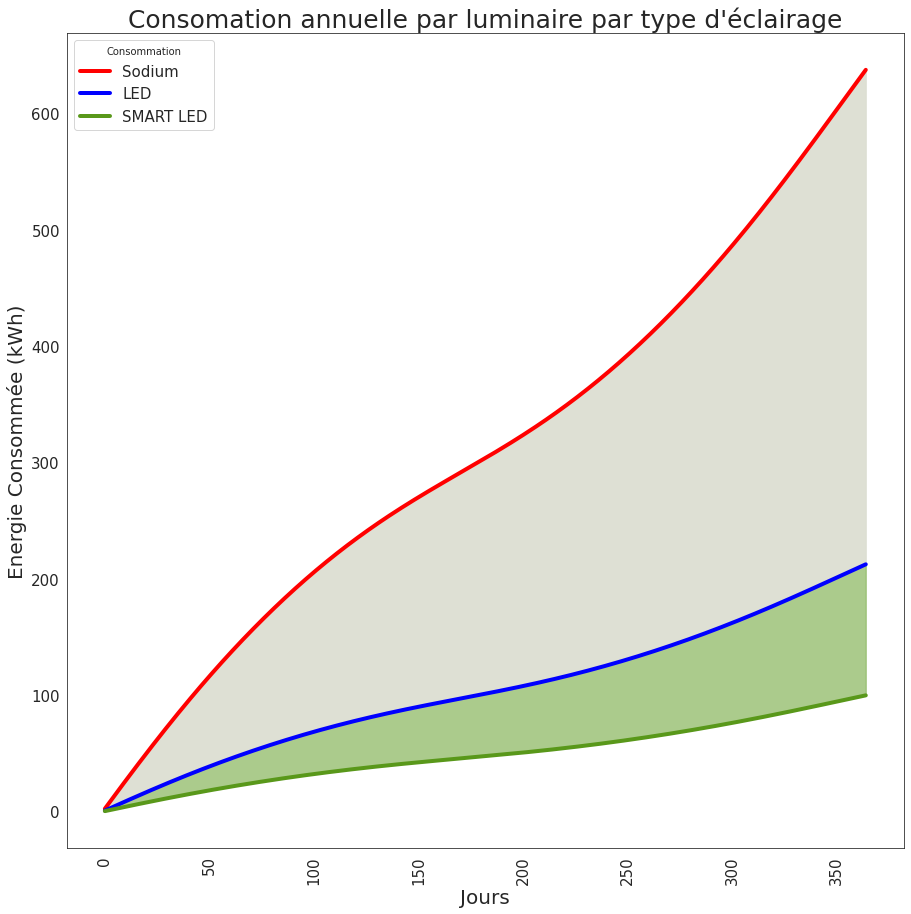

In [189]:
sns.set_style("white")

lw=4

sns.set_palette(palette="deep")
fig, ax = plt.subplots(figsize = (15,15))
ax1 = sns.lineplot(x=conso_df.index, 
                   linewidth=lw,
                   y = conso_df['SON_kwh'].cumsum(), 
                   color = 'red',label = 'Sodium' )
ax2 = sns.lineplot(x=conso_df.index,
                   linewidth=lw,
                   y = conso_df['LED_kwh'].cumsum(),
                   color='blue',label = 'LED' )
ax3 = sns.lineplot(x=conso_df.index, 
                   linewidth=lw,
                   y = conso_df['smart_A_LED_kwh'].cumsum(), 
                   color = '#59981A', label= 'smart model A')
# ax4 = sns.lineplot(x=conso_df.index, 
#                    linewidth=lw,
#                    y = conso_df['smart_B_LED_kwh'].cumsum(),
#                    color = '#59981A', label= 'smart model B')
# ax5 = sns.lineplot(x=conso_df.index, 
#                    linewidth=lw,
#                    y = conso_df['smart_C_LED_kwh'].cumsum(), 
#                    color = '#59981A', label= 'smart model C')

ax6 = plt.fill_between(conso_df.index,
                       conso_df['SON_kwh'].cumsum(),
                       conso_df['LED_kwh'].cumsum(),
                       color='#DBDDD0', 
                       alpha=0.9, label = 'Économies')

# ax7 = plt.fill_between(conso_df.index,
#                        conso_df['LED_kwh'].cumsum(),
#                        conso_df['smart_B_LED_kwh'].cumsum(),
#                        color='#666666',
#                        alpha=0.9, label = 'Économies')

ax8 = plt.fill_between(conso_df.index,
                       conso_df['LED_kwh'].cumsum(),
                       conso_df['smart_A_LED_kwh'].cumsum(),
                       color='#59981A', alpha=0.5,label = 'Économies')

# l1 = plt.legend([ax6],["Économies d'énergie"], loc='center left')
plt.legend(title='Consommation', loc='upper left',
           labels=['Sodium', 'LED', 'SMART LED'],
           fontsize = 15)
# plt.gca().add_artist(l1)
plt.yticks(fontsize=15)
plt.xticks(rotation=90, fontsize=15)
ax.set_xlabel("Jours", fontsize = 20)
ax.set_ylabel("Energie Consommée (kWh)", fontsize = 20)
plt.title("Consomation annuelle par luminaire par type d'éclairage",  fontsize = 25);
#plt.legend()
plt.savefig("../slcities/graphs/conso_per_light_per_year.svg", dpi=600, format='svg')

## Area Clustering

### Clustering with count data 

In [192]:
## Getting the data
X_cnt = gpd_global_cnt.drop(columns=['ED_ID', 'geometry','light', 'sensors'])

In [100]:
## Rescaling
# scaler = RobustScaler().fit(X_cnt)

In [101]:
## Saving the scaler
# joblib.dump(scaler,
#             '../slcities/model/slcities_robust_scaler')

['../slcities/model/slcities_robust_scaler']

In [193]:
robust_scaler = joblib.load('../slcities/model/slcities_robust_scaler')

In [194]:
X_scaled = robust_scaler.transform(X_cnt)

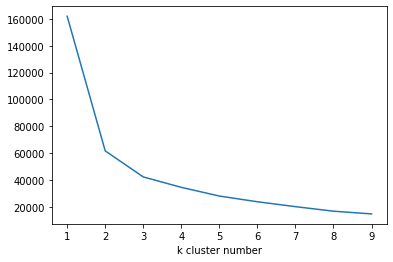

In [105]:
## Get optimal number of clusters (elbow method)
inertias = []

ks = range(1,10)
for k in ks:
    km_test = KMeans(n_clusters=k).fit(X_scaled)
    inertias.append(km_test.inertia_)

plt.plot(ks, inertias)
plt.xlabel('k cluster number');

In [106]:
## Defining the number of clusters
k=4

In [107]:
# ## Model training (kmeans)
# trained_kmeans_k4_cnt = KMeans(n_clusters=k).fit(X_scaled)
# ## Saving the model
# joblib.dump(trained_kmeans_k4_cnt,
#             '../slcities/model/trained_kmeans_k4.model')

['../slcities/model/trained_kmeans_k4.model']

In [195]:
## Importation of the trained model
k = 4
trained_kmeans_k4 = joblib.load('../slcities/model/trained_kmeans_k4.model')

In [196]:
## Data clustering
gpd_global_cnt['cluster'] = trained_kmeans_k4.predict(X_scaled)

In [197]:
gpd_global_cnt['cluster'].value_counts()

0    282
3     21
2     15
1      4
Name: cluster, dtype: int64

In [198]:
## Renaming the cluster
gpd_global_cnt['cluster'] = gpd_global_cnt['cluster'].map({3:1,
                                                           0:2,
                                                           2:3,
                                                           1:4})

In [199]:
gpd_global_cnt['cluster'].value_counts()

2    282
1     21
3     15
4      4
Name: cluster, dtype: int64

In [121]:
# gpd_global_cnt[['ED_ID', 'light','cluster']].to_csv('../slcities/data/gpd_cnt_lights.txt')

# Mapping 

## Density, lights, places

In [66]:
def create_map_1(gpd_global_cnt, places, lights):
    lat_center, lon_center = DUBLIN_CENTER_COORDS
    map_1 = folium.Map(location=[lat_center, lon_center],
                        zoom_start=10,
                        min_zoom=8,
                        tiles=None,
                        control_scale=True,
                        attr='SL Cities Project')

    dublin_layer = folium.TileLayer(tiles='CartoDB dark_matter',
                                    control_scale=True,
                                    overlay=False,
                                    name='Dublin')

    density_layer = folium.Choropleth(geo_data=gpd_global_cnt,
                                        name="density",
                                        overlay=True,
                                         show=False,
                                        data=gpd_global_cnt,
                                        columns=["ED_ID", "density"],
                                        key_on="feature.properties.ED_ID",
                                        fill_color="OrRd",
                                        fill_opacity=0.4,
                                        line_opacity=0.8,
                                        legend_name="Pop. density",
                                        threshold_scale=8,
                                        highlight=True)
######################################################## 
    light_marker_cluster = MarkerCluster(name='Lights',
                                         overlay=True,
                                         show=False,
                                            options={'maxZoom': 20,
                                                    'maxClusterRadius': 80,
                                                    'disableClusteringAtZoom': 13
                                            })

    for index, row in lights.iterrows():
        folium.CircleMarker(radius=0.1,
                            location=[row['latitude'], row['longitude']],
                            color="yellow",
                            fill=False).add_to(light_marker_cluster)
########################################################   
    

########################################################
    places_marker_cluster = MarkerCluster(name='Places',
                                        overlay=True,
                                         show=False,
                                            options={'maxZoom': 20,
                                                    'maxClusterRadius': 80,
                                                    'disableClusteringAtZoom': 13
                                            })

    for index, row in places.iterrows():
        folium.CircleMarker(radius=0.1,
                            location=[row['latitude'], row['longitude']],
                            color="green",
                            fill=False).add_to(places_marker_cluster)
########################################################
    dublin_layer.add_to(map_1)
    density_layer.add_to(map_1)
    places_marker_cluster.add_to(map_1)
    light_marker_cluster.add_to(map_1)

    folium.LayerControl().add_to(map_1)
    return map_1

In [62]:
gpd_global_cnt.columns

Index(['ED_ID', 'Shape__Area', 'geometry', 'art_gallery', 'atm', 'bakery',
       'bank', 'bar', 'beauty_salon', 'bus_station', 'cafe', 'car_dealer',
       'car_rental', 'car_repair', 'car_wash', 'clothing_store',
       'convenience_store', 'department_store', 'doctor', 'drugstore',
       'electrician', 'electronics_store', 'food', 'furniture_store',
       'gas_station', 'grocery_or_supermarket', 'gym', 'hair_care',
       'hardware_store', 'health', 'home_goods_store', 'hospital',
       'jewelry_store', 'laundry', 'liquor_store', 'local_government_office',
       'lodging', 'movie_theater', 'museum', 'night_club', 'park', 'parking',
       'pharmacy', 'plumber', 'police', 'post_office', 'primary_school',
       'real_estate_agency', 'restaurant', 'school', 'shopping_mall', 'spa',
       'stadium', 'store', 'supermarket', 'pop', 'light', 'sensors',
       'total_places', 'cluster'],
      dtype='object')

In [67]:
tmp_gpd_global_cnt = gpd_global_cnt.copy()
tmp_gpd_global_cnt['density'] = tmp_gpd_global_cnt['pop'] / tmp_gpd_global_cnt['Shape__Area']
map_data = create_map_1(tmp_gpd_global_cnt, places, lights)

In [68]:
map_data

In [69]:
map_data.save('../slcities/maps/data_map.html')

## Clustering maps

In [20]:
places['coordinates'] = list(zip(places['latitude'], places['longitude']))

In [113]:
lat_center, lon_center = DUBLIN_CENTER_COORDS

In [118]:
clustering_map = folium.Map(location=[lat_center, lon_center],
                zoom_start=10,
                min_zoom=8,
                tiles= None,
                control_scale=True,
                attr='SL Cities Project')


dublin_layer = folium.TileLayer(tiles= 'CartoDB dark_matter',
                 control_scale = True,
                 overlay = False,
                 name = 'Dublin')




cluster_layer = folium.Choropleth(geo_data=gpd_global_cnt,
                                name="Clusters",
                                data=gpd_global_cnt,
                                columns=["ED_ID","cluster"],
                                key_on="feature.properties.ED_ID",
                                fill_color='Set1',
                                fill_opacity=0.4,
                                line_opacity=0.8,
                                legend_name="Clusters",
                                threshold_scale=k,
                                highlight=True,
)


sensors_marker_cluster = MarkerCluster(name='Sensors',
                                       overlay=True,
                                       show=False,
                                       options={'maxZoom': 20,
                                                'maxClusterRadius': 80,
                                                'disableClusteringAtZoom': 2
                                               })

# add places marker to sensor marker cluster
for index, row in sensors.iterrows():
    folium.CircleMarker(
        radius=0.1,
        location=[row['latitude'],row['longitude']],
        color="white",
        fill=False
    ).add_to(sensors_marker_cluster)

    


dublin_layer.add_to(clustering_map)
cluster_layer.add_to(clustering_map)
sensors_marker_cluster.add_to(clustering_map)


folium.LayerControl().add_to(clustering_map);

In [119]:
clustering_map

In [88]:
clustering_map.save('../slcities/maps/clustering_map.html')

### Clustering map nice

In [48]:
from slcities.params import NICE_CENTER_COORDS

In [49]:
lat_center_nice, lon_center_nice = NICE_CENTER_COORDS

In [137]:
# https://medium.com/analytics-vidhya/create-and-visualize-choropleth-map-with-folium-269d3fd12fa0
import branca.colormap as cmp

step = cmp.StepColormap(
 ['blue', 'green', 'purple'],
 vmin=1.8, vmax=4,
 index=[1.8, 2.5, 3.3, 4],  #for change in the colors, not used fr linear
 caption='Color Scale for Map'    #Caption for Color scale or Legend
)
step


In [159]:
truc = gpd_global_cnt_nice[["ED_ID","cluster"]].set_index('cluster').to_dict()['ED_ID']
machin = [str(x) for x in gpd_global_cnt_nice.cluster]
machin

['2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '3',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '3',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '3',
 '3',
 '2',
 '2',
 '2',
 '2',
 '2',
 '3',
 '3',
 '2',
 '2',
 '2',
 '2',
 '3',
 '2',
 '2',
 '3',
 '3',
 '2',
 '2',
 '2',
 '2',
 '2',
 '3',
 '4',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '4',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '3',
 '2',
 '2',
 '3',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '3',
 '2',
 '3',
 '2',
 '3',
 '2',
 '2',
 '3',
 '2',
 '2',
 '3',
 '2',
 '3',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '2',
 '3',
 '3',
 '2',
 '3',
 '3',
 '3',
 '2',
 '2',
 '3',
 '3',
 '3',
 '3',
 '2',
 '2',
 '2',
 '2']

In [127]:
# colourstep = folium.LinearColormap(['blue','green','purple'], vmin=2, vmax=4).to_step(3)
# # df_dict = gpd_global_cnt_nice.set_index('zip_code')


In [172]:
clustering_map_nice = folium.Map(location=[lat_center_nice, lon_center_nice],
                zoom_start=12,
                min_zoom=8,
                tiles= None,
                control_scale=True,
                attr='SL Cities Project')


nice_layer = folium.TileLayer(tiles= 'CartoDB dark_matter',
                 control_scale = True,
                 overlay = False,
                 name = 'Dublin')




cluster_layer_nice = folium.Choropleth(geo_data=gpd_global_cnt_nice,
                                name="Clusters",
                                data=gpd_global_cnt_nice,
                                columns=["ED_ID","cluster"],
                                key_on="feature.properties.ED_ID",
                                fill_color='Set1',
                                fill_opacity=0.4,
                                line_opacity=0.8,
                                legend_name="Clusters",
                                threshold_scale=4,
                                highlight=True,
)


    


nice_layer.add_to(clustering_map_nice)
cluster_layer_nice.add_to(clustering_map_nice)
folium.LayerControl().add_to(clustering_map_nice);

In [173]:
clustering_map_nice

In [174]:
# clustering_map_nice.save('../slcities/maps/clustering_map_nice.html')

## Lighting models using clustering information vs baseline

In [190]:
conso_per_year_df

night_length       1.529443e+07
SON_kwh            6.372680e+02
LED_kwh            2.124227e+02
smart_A_LED_kwh    9.983866e+01
smart_B_LED_kwh    1.253294e+02
smart_C_LED_kwh    1.189567e+02
dtype: float64

In [276]:
gpd_global_cnt.light.sum()

45017.0

In [238]:
baseline_conso_SON_pery_whole_dublin = gpd_global_cnt.light.sum() * conso_per_year_df.SON_kwh
baseline_conso_LED_pery_whole_dublin = gpd_global_cnt.light.sum() * conso_per_year_df.LED_kwh
smart_conso_pery_per_cluster_C1 = gpd_global_cnt[gpd_global_cnt.cluster==1].light.sum() * conso_per_year_df.smart_A_LED_kwh
smart_conso_pery_per_cluster_C2 = gpd_global_cnt[gpd_global_cnt.cluster==2].light.sum() * conso_per_year_df.smart_B_LED_kwh
smart_conso_pery_per_cluster_C3 = gpd_global_cnt[gpd_global_cnt.cluster==3].light.sum() * conso_per_year_df.smart_C_LED_kwh
smart_conso_pery_per_cluster_C4 = gpd_global_cnt[gpd_global_cnt.cluster==4].light.sum() * conso_per_year_df.smart_C_LED_kwh


smart_conso_pery_per_cluster = smart_conso_pery_per_cluster_C1+smart_conso_pery_per_cluster_C2+smart_conso_pery_per_cluster_C3+smart_conso_pery_per_cluster_C4

In [320]:
gpd_global_cnt[gpd_global_cnt.cluster==1].shape

(19, 60)

<AxesSubplot:>

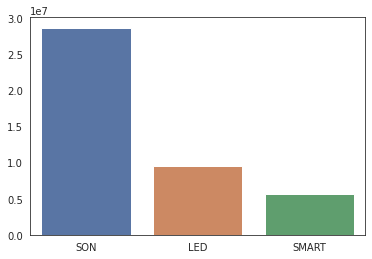

In [344]:
sns.barplot(y=[baseline_conso_SON_pery_whole_dublin, baseline_conso_LED_pery_whole_dublin, smart_conso_pery_per_cluster], x=['SON', 'LED', 'SMART'])

## economies consommation vs cost of replacement

In [345]:

## cost = light cost * life
# replacement_cost_SON_pery = cost_SON_light*(hours_per_year/life_time) # lifetime of 24 k hours. If 4000h / year-> lifetime coef = 1/6
# replacement_cost_LED_pery = cost_LED_light*(hours_per_year/life_time) # lifetime of 24 k hours. If 4000h / year-> lifetime coef = 1/6

# replacement_cost_SON_pery = 20*(4000/24000)
# replacement_cost_LED_pery = 500*(4000/100000)

In [239]:
economies_energie_per_year_SON_vs_SMART_kWh = baseline_conso_SON_pery_whole_dublin - smart_conso_pery_per_cluster
economies_energie_per_year_SON_vs_SMART_kWh

23090761.72484278

In [240]:
economies_per_year_SON_vs_SMART_euros = economies_energie_per_year_SON_vs_SMART_kWh*0.14
economies_per_year_SON_vs_SMART_euros

3232706.6414779895

In [359]:
baseline_conso_SON_pery_whole_dublin*0.14

4016305.3604391674

In [360]:
economies_per_year_SON_vs_SMART_euros/(baseline_conso_SON_pery_whole_dublin*0.14)

0.804895632020496

In [334]:
np.arange(1,31)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30])

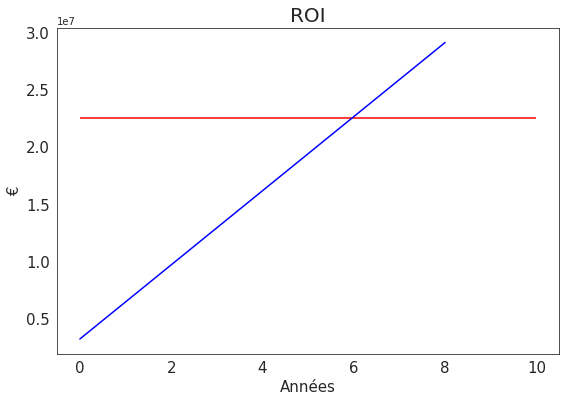

In [250]:
fig, ax = plt.subplots(figsize=(9,6))
plt.plot(np.arange(1,10)*economies_per_year_SON_vs_SMART_euros, color='blue')
plt.hlines(gpd_global_cnt.light.sum()*500, xmin=0, xmax=10, color='red')

plt.yticks(fontsize=15)
plt.xticks(fontsize=15)
ax.set_ylabel("€", fontsize = 15)
ax.set_xlabel("Années", fontsize = 15)
# ax.set_ylim(0, 30_000_000)
# ax.ticklabel_format(useOffset=False, style='plain')
plt.title('ROI',  fontsize = 20);
plt.savefig("../slcities/graphs/ROI.svg", dpi=600, format='svg')

In [356]:
gpd_global_cnt.light.sum()*500

22508500.0

In [362]:
test.head()

,ED_ID,Shape__Area,geometry,art_gallery,atm,bakery,bank,bar,beauty_salon,bus_station,cafe,car_dealer,car_rental,car_repair,car_wash,clothing_store,convenience_store,department_store,doctor,drugstore,electrician,electronics_store,food,furniture_store,gas_station,grocery_or_supermarket,gym,hair_care,hardware_store,health,home_goods_store,hospital,jewelry_store,laundry,liquor_store,local_government_office,lodging,movie_theater,museum,night_club,park,parking,pharmacy,plumber,police,post_office,primary_school,real_estate_agency,restaurant,school,shopping_mall,spa,stadium,store,supermarket,pop,light,sensors,total_places,cluster
0,267070,9.623428e+05,"POLYGON ((-6.14619 53.28349, -6.14810 53.28267...",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2225,0.0,0.0,0.0,2
1,267090,2.690560e+06,"POLYGON ((-6.18041 53.27607, -6.17807 53.27493...",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1445,0.0,0.0,0.0,2
2,268025,8.953063e+05,"POLYGON ((-6.22254 53.38053, -6.22286 53.37966...",0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2051,158.0,0.0,5.0,2
3,267158,6.936444e+07,"POLYGON ((-6.34697 53.45360, -6.34454 53.44991...",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,9602,0.0,0.0,2.0,1
4,267023,1.399951e+06,"POLYGON ((-6.16683 53.29051, -6.16826 53.28882...",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2316,0.0,0.0,0.0,2


In [200]:
test = gpd_global_cnt[['ED_ID', 'light', 'cluster']].copy()
test

,ED_ID,light,cluster
0,267070,0.0,2
1,267090,0.0,2
2,268025,158.0,2
3,267158,0.0,1
4,267023,0.0,2
...,...,...,...
317,268027,302.0,2
318,268051,267.0,2
319,268111,295.0,2
320,267122,0.0,2


In [201]:
test['SON_kwh'] = test['light'] * conso_per_year_df.SON_kwh
test['LED_kwh'] = test['light'] * conso_per_year_df.LED_kwh
test['Smart_kwh'] = np.nan
test.loc[test.cluster==1,'Smart_kwh'] = test[test.cluster==1]['light'] * conso_per_year_df.smart_A_LED_kwh
test.loc[test.cluster==2,'Smart_kwh'] = test[test.cluster==2]['light'] * conso_per_year_df.smart_B_LED_kwh
test.loc[test.cluster==3,'Smart_kwh'] = test[test.cluster==3]['light'] * conso_per_year_df.smart_C_LED_kwh
test.loc[test.cluster==4,'Smart_kwh'] = test[test.cluster==4]['light'] * conso_per_year_df.smart_C_LED_kwh

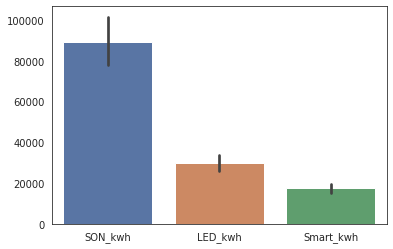

In [207]:
sns.barplot(data= test[['SON_kwh', 'LED_kwh', 'Smart_kwh']]);

In [208]:
test[['SON_kwh', 'LED_kwh', 'Smart_kwh']].sum()

SON_kwh      2.868790e+07
LED_kwh      9.562632e+06
Smart_kwh    5.597134e+06
dtype: float64

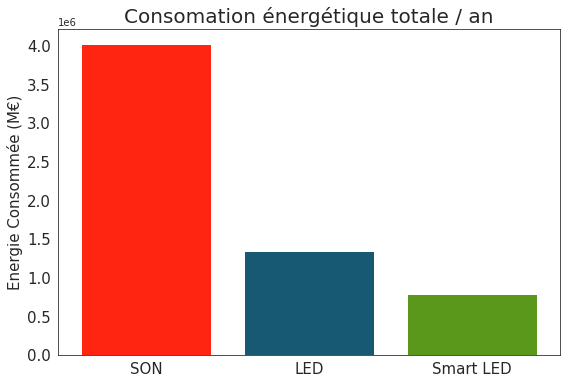

In [236]:
# fig,ax=plt.subplot(figsize=(9,6))
# fig = figure()
fig, ax = plt.subplots(figsize=(9,6))
plt.bar(x=['SON', 'LED', 'Smart LED'], 
        height=test[['SON_kwh', 'LED_kwh', 'Smart_kwh']].sum()*0.14,
       color=['#FF2511', '#175873', '#59981A']);
plt.yticks(fontsize=15)
plt.xticks(fontsize=15)
ax.set_ylabel("Energie Consommée (M€)", fontsize = 15)
plt.title('Consomation énergétique totale / an',  fontsize = 20);
plt.savefig("../slcities/graphs/conso_total_per_year.svg", dpi=600, format='svg')

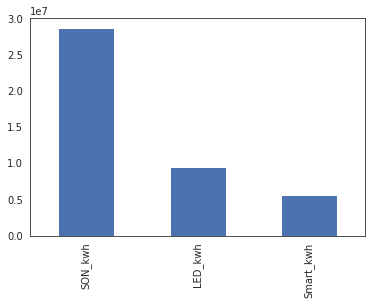

In [205]:
test[['SON_kwh', 'LED_kwh', 'Smart_kwh']].sum().plot(kind='bar');

In [410]:
total = test.groupby('cluster')[['SON_kwh', 'LED_kwh', 'Smart_kwh']].sum().reset_index()

In [411]:
total

,cluster,SON_kwh,LED_kwh,Smart_kwh
0,1,7.647217e+03,2.549072e+03,1.198064e+03
1,2,2.422893e+07,8.076310e+06,4.765023e+06
2,3,3.318255e+06,1.106085e+06,6.194075e+05
3,4,1.133063e+06,3.776875e+05,2.115050e+05


In [414]:
truc = total.melt(id_vars='cluster')
truc

,cluster,variable,value
0,1,SON_kwh,7.647217e+03
1,2,SON_kwh,2.422893e+07
2,3,SON_kwh,3.318255e+06
3,4,SON_kwh,1.133063e+06
4,1,LED_kwh,2.549072e+03
5,2,LED_kwh,8.076310e+06
6,3,LED_kwh,1.106085e+06
7,4,LED_kwh,3.776875e+05
8,1,Smart_kwh,1.198064e+03
9,2,Smart_kwh,4.765023e+06


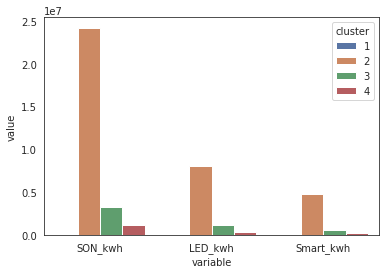

In [418]:
s = sns.barplot(x ="variable", y = 'value', data = truc, hue = "cluster")

In [ ]:
sns.barplot(x ="variable", y = 'value', data = truc, hue = "cluster")

In [ ]:
baseline_conso_SON_pery_whole_dublin = gpd_global_cnt.light.sum() * conso_per_year_df.SON_kwh
baseline_conso_LED_pery_whole_dublin = gpd_global_cnt.light.sum() * conso_per_year_df.LED_kwh
smart_conso_pery_per_cluster_C1 = gpd_global_cnt[gpd_global_cnt.cluster==1].light.sum() * conso_per_year_df.smart_A_LED_kwh
smart_conso_pery_per_cluster_C2 = gpd_global_cnt[gpd_global_cnt.cluster==2].light.sum() * conso_per_year_df.smart_B_LED_kwh
smart_conso_pery_per_cluster_C3 = gpd_global_cnt[gpd_global_cnt.cluster==3].light.sum() * conso_per_year_df.smart_C_LED_kwh
smart_conso_pery_per_cluster_C4 = gpd_global_cnt[gpd_global_cnt.cluster==4].light.sum() * conso_per_year_df.smart_C_LED_kwh


smart_conso_pery_per_cluster = smart_conso_pery_per_cluster_C1+smart_conso_pery_per_cluster_C2+smart_conso_pery_per_cluster_C3+smart_conso_pery_per_cluster_C4